In [1]:
# if hit plotting library issues, try resetting LD path for julia
# can set in ~/.local/share/jupyter/kernels/
@assert ENV["LD_LIBRARY_PATH"] == ""
import Pkg
pkgs = [
    "Revise",
    "FASTX",
    "BioSequences",
    "Kmers",
    "Graphs",
    "MetaGraphs",
    "SparseArrays",
    "ProgressMeter",
    "Distributions",
    "HiddenMarkovModels",
    "BioAlignments",
    "StatsBase",
    "Random",
    "StatsPlots",
    "Statistics",
    # "GraphMakie",
    "IterTools",
    "Primes",
    "OnlineStats",
    "IteratorSampling"
]
# Pkg.add(pkgs)
for pkg in pkgs
    eval(Meta.parse("import $pkg"))
end
# Pkg.develop(path="/global/cfs/projectdirs/m4269/cjprybol/Mycelia")
# Pkg.develop(path="../../..")
import Mycelia

┌ Warning: The active manifest file is an older format with no julia version entry. Dependencies may have been resolved with a different julia version.
└ @ /global/cfs/cdirs/m4269/cjprybol/Mycelia/Manifest.toml:0
[ Info: Precompiling Mycelia [453d265d-8292-4a7b-a57c-dce3f9ae6acd]
[ Info: Skipping precompilation since __precompile__(false). Importing Mycelia [453d265d-8292-4a7b-a57c-dce3f9ae6acd].


In [2]:
PROJECT_BASEDIR = dirname(pwd())
data_dir = joinpath(PROJECT_BASEDIR, "data")
genome_dir = mkpath(joinpath(data_dir, "genomes"))

"/global/cfs/cdirs/m4269/cjprybol/Mycelia/projects/variant-calling-benchmarking/data/genomes"

In [3]:
working_dir = joinpath(data_dir, "test")
mkpath(working_dir)

"/global/cfs/cdirs/m4269/cjprybol/Mycelia/projects/variant-calling-benchmarking/data/test"

In [4]:
# short_read_sets = unique(map(x -> match(r"^(.+\.\d+x)\.", x).captures[1], filter(x -> occursin(r"\.fna\.art", x) && occursin(r"\.fq\.gz", x) && !occursin("trimming_report", x) && !occursin("_val_", x), sort(readdir(genome_dir, join=true), by=x->filesize(x)))))
# # forward = short_read_set * ".1_val_1.fq.gz"
# # reverse = short_read_set * ".2_val_2.fq.gz"

In [5]:
long_read_fastqs = sort(filter(x -> occursin(r"\.filtlong\.fq\.gz$", x), readdir(genome_dir, join=true)), by=x->filesize(x))
fastq = long_read_fastqs[1]

"/global/cfs/cdirs/m4269/cjprybol/Mycelia/projects/variant-calling-benchmarking/data/genomes/fF3EHHs.fna.normalized.vcf.fna.badread.10x.filtlong.fq.gz"

In [6]:
reference_fasta = replace(fastq, r"\.badread.*" => "")

"/global/cfs/cdirs/m4269/cjprybol/Mycelia/projects/variant-calling-benchmarking/data/genomes/fF3EHHs.fna.normalized.vcf.fna"

kmer_type = Kmers.Kmer{BioSequences.DNAAlphabet{4}, 3, 1}
(sampling_points, kmer_counts, hit_eof) = ([0, 1, 10, 100, 118], [0, 1, 9, 30, 32], false)
  4.802783 seconds (1.46 M allocations: 92.625 MiB, 99.99% compilation time)
(k, predicted_saturation) = (3, 1.0)


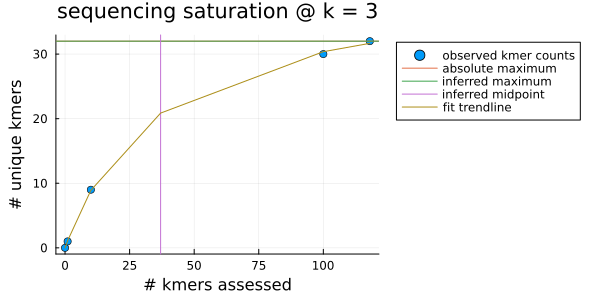

kmer_type = Kmers.Kmer{BioSequences.DNAAlphabet{4}, 5, 1}
(sampling_points, kmer_counts, hit_eof) = ([0, 1, 10, 100, 1000, 8261], [0, 1, 10, 88, 439, 512], false)
  0.000098 seconds (354 allocations: 33.234 KiB)
(k, predicted_saturation) = (5, 1.0)


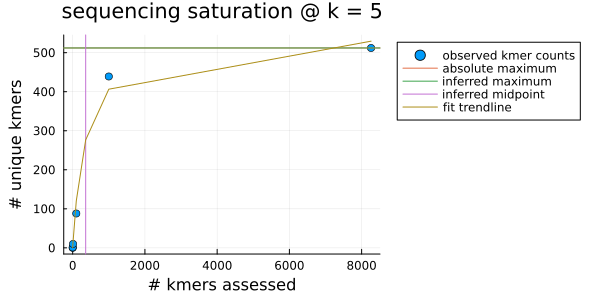

kmer_type = Kmers.Kmer{BioSequences.DNAAlphabet{4}, 7, 1}
(sampling_points, kmer_counts, hit_eof) = ([0, 1, 10, 100, 1000, 10000, 10136], [0, 1, 10, 99, 949, 3076, 3101], true)
  0.000088 seconds (194 allocations: 18.016 KiB)
(k, predicted_saturation) = (7, 0.3785400390625)


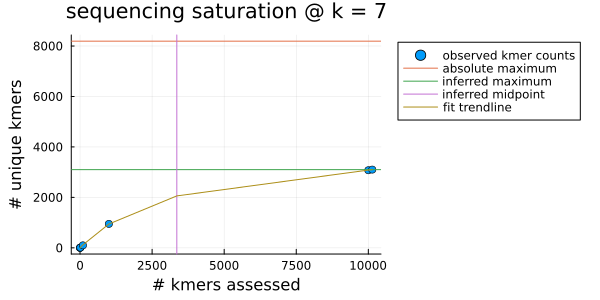

kmer_type = Kmers.Kmer{BioSequences.DNAAlphabet{4}, 11, 1}
(sampling_points, kmer_counts, hit_eof) = ([0, 1, 10, 100, 1000, 10000, 10096], [0, 1, 10, 100, 1000, 5154, 5205], true)
  0.000076 seconds (225 allocations: 21.125 KiB)
(k, predicted_saturation) = (11, 0.0024819374084472656)


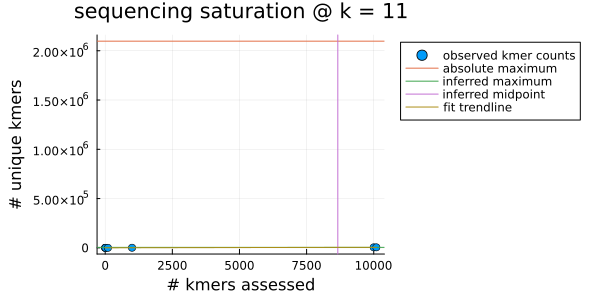

11

In [7]:
k = Mycelia.assess_dnamer_saturation([fastq])

In [8]:
kmer_type = Kmers.DNAKmer{k, 1}

DNAKmer{11, 1} (alias for Kmers.Kmer{BioSequences.DNAAlphabet{2}, 11, 1})

In [9]:
function fasta_to_reference_kmer_counts(;kmer_type, fasta)
    kmer_counts = Dict{kmer_type, Int}()
    for record in Mycelia.open_fastx(fasta)
        record_sequence = BioSequences.LongDNA{2}(FASTX.sequence(record))
        forward_counts = StatsBase.countmap(kmer for (i, kmer) in Kmers.EveryKmer{kmer_type}(record_sequence))
        reverse_counts = StatsBase.countmap(kmer for (i, kmer) in Kmers.EveryKmer{kmer_type}(BioSequences.reverse_complement(record_sequence)))
        record_counts = merge(+, forward_counts, reverse_counts)
        merge!(+, kmer_counts, record_counts)
    end
    return kmer_counts
end

# reference_kmers = Set(keys(fasta_to_reference_kmer_counts(kmer_type = kmer_type, fasta = reference_fasta)))
reference_kmer_counts = fasta_to_reference_kmer_counts(kmer_type=kmer_type, fasta=reference_fasta)

Dict{Kmers.DNAKmer{11, 1}, Int64} with 2018 entries:
  CACACGTAGCC => 1
  AGTCCGCGAGC => 1
  AGGGACCTACC => 1
  CTCTAGGTAGG => 1
  GGTAGGACTTA => 1
  GAATATGGTGA => 1
  CTCCATTTTTC => 1
  TTACGCGTGCC => 1
  TGGGCGTGTCC => 1
  AAGCGTTAATG => 1
  CTCGATTTCAC => 1
  GCAGAGTGACC => 1
  TCCATGGGATG => 1
  ACGTGTTAAGC => 1
  TTAGTTTCGAG => 1
  TAGGGCAGGGG => 1
  TTGAGGGTGTT => 1
  AACAAGCAGTA => 1
  ACGTGTGGGTC => 1
  GTTTGGACAAA => 1
  TAGAGAACGCA => 1
  CGTCTCAGAGA => 1
  CGATACAGGGC => 1
  ATCTCTGAGAC => 1
  TTCTCGGATGG => 1
  ⋮           => ⋮

In [10]:
records = collect(Mycelia.open_fastx(fastq))

10-element Vector{FASTX.FASTQ.Record}:
 FASTQ.Record:
  description: "97e8d3a6-40a3-f719-3337-6aec187a3514 fF3EHHs,-strand,0-1021 length=1026 error-free_length=1028 read_identity=95.450%"
     sequence: "TATTGCTTTCAAGATTGGTGCTTGCGTTCTCTAGGTAGG…"
      quality: "IANWG*?;?>UADK3OH{C9BCX>H?+@F@@?G1CE;D:…"
 FASTQ.Record:
  description: "cc35c08c-73e8-d6a0-9066-efc6698f16e1 fF3EHHs,+strand,0-1021 length=1011 error-free_length=1026 read_identity=93.916%"
     sequence: "TTGCTGTTGTGACGGTTGAGGGTGCTCTTCTTTGGTCTC…"
      quality: "??NHCAKP>E0<E;E7KJ@F7*&3.**'*')&,.1&%(#…"
 FASTQ.Record:
  description: "1d8e4953-918f-9fbd-ff15-1106543b4720 fF3EHHs,-strand,0-1021 length=1029 error-free_length=1037 read_identity=97.723%"
     sequence: "TCAGTTGACGTATTGCTTTCAAGATTGGTGCTTGCGTTC…"
      quality: "SA:4,/'+3-/CIE{%-GEDD{FJAOIA)OE(??GBD=H…"
 FASTQ.Record:
  description: "072f6bcb-74df-ffd6-f754-733853ed4eba fF3EHHs,-strand,0-1021 length=1012 error-free_length=1024 read_identity=92.823%"
     sequence: "G

In [11]:
fit_mean = OnlineStats.fit!(OnlineStats.Mean(), IterTools.chain(FASTX.quality_scores(record) for record in records))

Mean: n=10_196 | value=26.6636

In [12]:
fit_extrema = OnlineStats.fit!(OnlineStats.Extrema(), IterTools.chain(FASTX.quality_scores(record) for record in records))

Extrema: n=10_196 | value=(min = 2.0, max = 90.0, nmin = 8, nmax = 182)

In [13]:
fit_variance = OnlineStats.fit!(OnlineStats.Variance(), IterTools.chain(FASTX.quality_scores(record) for record in records))
standard_deviation = sqrt(OnlineStats.value(fit_variance))

15.438682924699615

In [14]:
threshold = max(OnlineStats.values(fit_extrema).min, floor(OnlineStats.value(fit_mean) - standard_deviation))

11.0

In [15]:
read_quality_scores = [collect(FASTX.quality_scores(record)) for record in records]

10-element Vector{Vector{Int8}}:
 [40, 32, 45, 54, 38, 9, 30, 26, 30, 29  …  90, 29, 31, 43, 18, 34, 25, 33, 29, 29]
 [30, 30, 45, 39, 34, 32, 42, 47, 29, 36  …  34, 41, 39, 37, 19, 35, 26, 19, 43, 43]
 [50, 32, 25, 19, 11, 14, 6, 10, 18, 12  …  10, 37, 18, 43, 35, 39, 41, 29, 24, 28]
 [38, 37, 41, 44, 19, 37, 90, 40, 29, 38  …  25, 31, 34, 35, 41, 34, 31, 42, 20, 8]
 [39, 44, 90, 28, 40, 26, 12, 18, 31, 21  …  35, 27, 45, 35, 90, 33, 17, 28, 42, 43]
 [39, 34, 4, 6, 8, 35, 31, 34, 28, 35  …  23, 39, 29, 35, 6, 28, 32, 27, 36, 41]
 [28, 27, 9, 3, 11, 17, 11, 4, 17, 5  …  10, 40, 90, 21, 37, 31, 36, 37, 34, 40]
 [31, 43, 39, 43, 34, 13, 20, 42, 34, 13  …  30, 43, 27, 33, 16, 8, 13, 13, 22, 7]
 [13, 10, 10, 12, 31, 25, 18, 10, 26, 17  …  22, 18, 9, 9, 5, 15, 15, 8, 22, 42]
 [4, 13, 5, 9, 18, 3, 8, 41, 41, 31  …  38, 28, 24, 7, 43, 90, 46, 45, 17, 29]

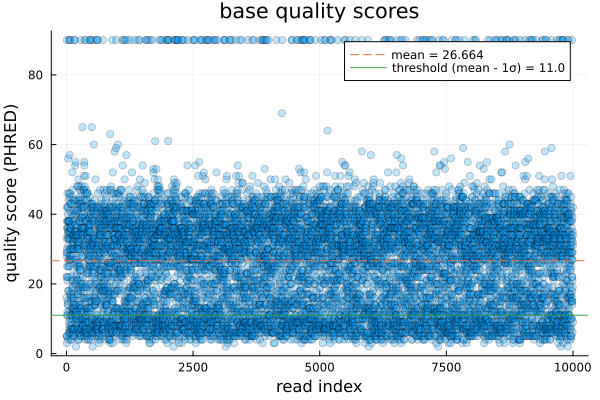

In [16]:
p = StatsPlots.scatter(
    IteratorSampling.itsample(IterTools.chain(read_quality_scores...), 10^4),
    title = "base quality scores",
    xlabel = "read index",
    ylabel = "quality score (PHRED)",
    # color = :black,
    alpha = 0.25,
    label = nothing)

StatsPlots.hline!(
    p,
    [OnlineStats.value(fit_mean)],
    labels = "mean = $(round(OnlineStats.value(fit_mean), digits=3))",
    linestyle = :dash
)

StatsPlots.hline!(
    p,
    [threshold],
    labels = "threshold (mean - 1σ) = $(threshold)",
    linestyle = :solid
)

In [17]:
# make a dictionary associating all kmers with their quality scores
all_kmer_quality_support = Dict{kmer_type, Vector{Vector{Float64}}}()
for record in records
    record_quality_scores = collect(FASTX.quality_scores(record))
    record_quality_score_slices = [record_quality_scores[i:i+k-1] for i in 1:length(record_quality_scores)-k+1]
    sequence = BioSequences.LongDNA{2}(FASTX.sequence(record))
    for ((i, kmer), kmer_base_qualities) in zip(Kmers.EveryKmer{kmer_type}(sequence), record_quality_score_slices)
        if haskey(all_kmer_quality_support, kmer)
            push!(all_kmer_quality_support[kmer], kmer_base_qualities)
        else
            all_kmer_quality_support[kmer] = [kmer_base_qualities]
        end
    end
end
all_kmer_quality_support

Dict{Kmers.DNAKmer{11, 1}, Vector{Vector{Float64}}} with 6199 entries:
  TTCGTCTTGAT => [[14.0, 5.0, 6.0, 4.0, 4.0, 18.0, 6.0, 2.0, 7.0, 11.0, 6.0]]
  ATCAATAGTTA => [[43.0, 30.0, 31.0, 27.0, 38.0, 42.0, 17.0, 35.0, 4.0, 7.0, 21…
  AGGGACCTACC => [[6.0, 7.0, 39.0, 7.0, 28.0, 31.0, 36.0, 41.0, 32.0, 40.0, 21.…
  TAGGCCAGACG => [[19.0, 90.0, 33.0, 38.0, 37.0, 90.0, 26.0, 6.0, 8.0, 19.0, 6.…
  GTGTTGGGATG => [[5.0, 6.0, 18.0, 15.0, 5.0, 44.0, 12.0, 40.0, 16.0, 6.0, 3.0]]
  TCTAAAGCAGA => [[16.0, 10.0, 6.0, 40.0, 14.0, 35.0, 9.0, 35.0, 33.0, 24.0, 15…
  GTTGGGATGTG => [[18.0, 15.0, 5.0, 44.0, 12.0, 40.0, 16.0, 6.0, 3.0, 4.0, 9.0]]
  AAGAAAGTATT => [[13.0, 6.0, 3.0, 2.0, 14.0, 12.0, 5.0, 5.0, 12.0, 14.0, 5.0]]
  CTCGATTTCAC => [[90.0, 44.0, 90.0, 27.0, 30.0, 43.0, 8.0, 30.0, 43.0, 33.0, 3…
  ACGTGTTAAGC => [[10.0, 34.0, 34.0, 27.0, 45.0, 38.0, 23.0, 13.0, 37.0, 19.0, …
  TTAGTTTCGAG => [[29.0, 35.0, 16.0, 40.0, 36.0, 41.0, 21.0, 37.0, 20.0, 32.0, …
  GGATGGCGCTG => [[8.0, 12.0, 28.0, 6.0, 2

In [18]:
kmer_counts = Mycelia.count_kmers(kmer_type, fastq)

OrderedCollections.OrderedDict{Kmers.DNAKmer{11, 1}, Int64} with 6199 entries:
  AAAAAACAAAT => 1
  AAAAACAAATA => 1
  AAAAACAATTG => 4
  AAAAACAGAAC => 1
  AAAAACGATTG => 1
  AAAAACGGAAC => 3
  AAAAAGGGACT => 1
  AAAAATAGGAG => 1
  AAAAATCAACA => 1
  AAAAATGGAGG => 2
  AAAACAAATAT => 1
  AAAACAATTGA => 4
  AAAACAGAACC => 1
  AAAACGATTGA => 1
  AAAACGGAACC => 3
  AAAAGAGGGTA => 1
  AAAAGCAATTG => 1
  AAAAGGGACTC => 1
  AAAATAGGAGG => 1
  AAAATATGGTG => 1
  AAAATCAACAG => 1
  AAAATCGCTGG => 1
  AAAATGGAGGG => 2
  AAACAAATATG => 1
  AAACAAGAAGC => 1
  ⋮           => ⋮

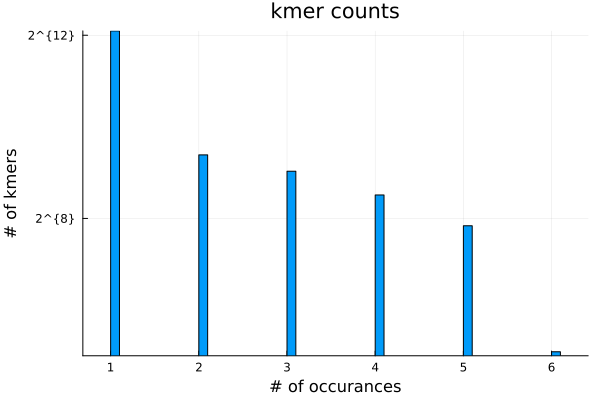

In [19]:
kmer_indices = Dict(kmer => i for (i, kmer) in enumerate(keys(kmer_counts)))

StatsPlots.histogram(
    collect(values(kmer_counts)),
    legend=false,
    title = "kmer counts",
    xlabel = "# of occurances",
    ylabel = "# of kmers",
    yscale = :log2
    # color = :black
)

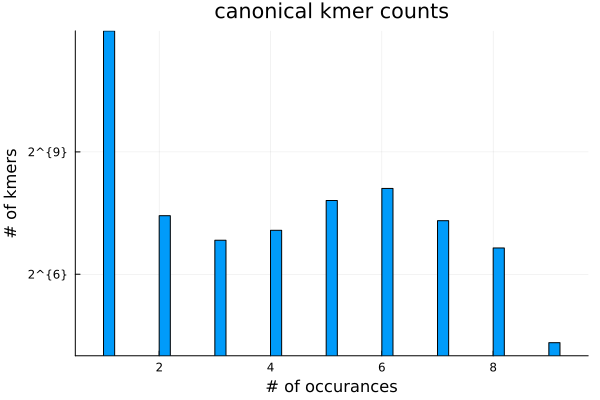

In [20]:
canonical_kmer_counts = Mycelia.count_canonical_kmers(kmer_type, fastq)
kmer_indices = Dict(kmer => i for (i, kmer) in enumerate(keys(canonical_kmer_counts)))

StatsPlots.histogram(
    collect(values(canonical_kmer_counts)),
    legend=false,
    title = "canonical kmer counts",
    xlabel = "# of occurances",
    ylabel = "# of kmers",
    yscale = :log2
    # color = :black
)

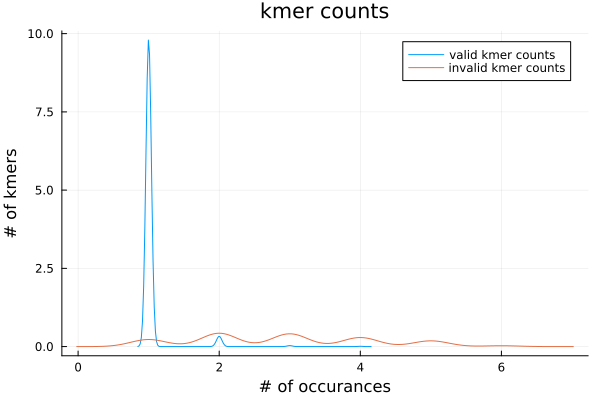

In [28]:
valid_kmer_counts = [count for (kmer, count) in kmer_counts if !(kmer in keys(reference_kmer_counts))]

invalid_kmer_counts = [count for (kmer, count) in kmer_counts if (kmer in keys(reference_kmer_counts))]

# StatsPlots.histogram(
#     [
#         [count for (kmer, count) in kmer_counts if !(kmer in keys(reference_kmer_counts))],
#         [count for (kmer, count) in kmer_counts if (kmer in keys(reference_kmer_counts))]
#     ],
#     title = "kmer counts",
#     legend = :topright,
#     labels = ["valid kmer counts" "invalid kmer counts"],
#     xlabel = "# of occurances",
#     ylabel = "# of kmers",
#     yscale = :log2
#     # color = :black
# )



StatsPlots.density(
    [valid_kmer_counts, invalid_kmer_counts],
    title = "kmer counts",
    legend = :topright,
    labels = ["valid kmer counts" "invalid kmer counts"],
    xlabel = "# of occurances",
    ylabel = "# of kmers",
    # xlims=(0.5, maximum(valid_kmer_counts))
    # yscale = :log2
    # color = :black
)

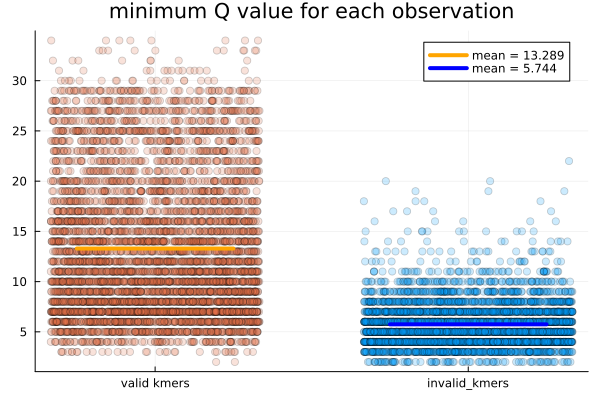

In [29]:
function jitter(x, n)
    return [x + rand() / 3 * (ifelse(rand(Bool), 1, -1)) for i in 1:n]
end

reference_kmers = sort(collect(keys(reference_kmer_counts)))

# here we are asking what is the minimum quality of the kmer for all considered kmers
# all_kmer_quality_support
valid_minimum_qualities = Float64[]
invalid_minimum_qualities = Float64[]
for (kmer, quality_values) in all_kmer_quality_support
    minimums = minimum.(quality_values)
    if kmer in reference_kmers
        append!(valid_minimum_qualities, minimums)
    else
        append!(invalid_minimum_qualities, minimums)
    end
end

p = StatsPlots.scatter(
    [jitter(2, length(invalid_minimum_qualities)), jitter(1, length(valid_minimum_qualities))],
    [invalid_minimum_qualities, valid_minimum_qualities],
    alpha=0.2,
    title = "minimum Q value for each observation",
    xticks = ((1, 2), ("valid kmers", "invalid_kmers")),
    labels = nothing
)
StatsPlots.plot!(p, 
    [0.75, 1.25],
    [Statistics.mean(valid_minimum_qualities), Statistics.mean(valid_minimum_qualities)],
    linewidth=4,
    color=:orange,
    label = "mean = $(round(Statistics.mean(valid_minimum_qualities), digits=3))")
StatsPlots.plot!(p,
    [1.75, 2.25],
    [Statistics.mean(invalid_minimum_qualities), Statistics.mean(invalid_minimum_qualities)],
    linewidth=4,
    color=:blue,
    label="mean = $(round(Statistics.mean(invalid_minimum_qualities), digits=3))")

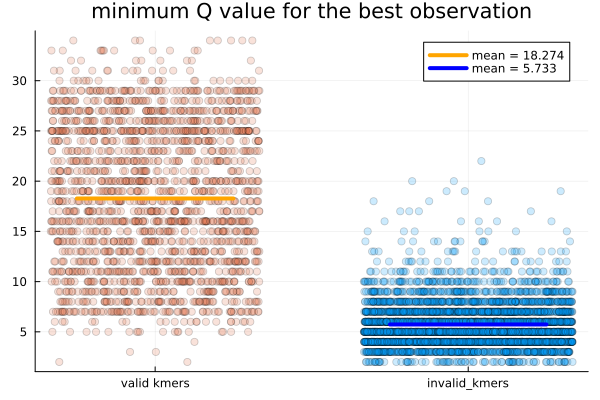

In [30]:
# here we ask what is the the minimum quality of the BEST observation for all considered kmers
valid_max_minimum_qualities = Float64[]
invalid_max_minimum_qualities = Float64[]
for (kmer, quality_values) in all_kmer_quality_support
    minimums = minimum.(quality_values)
    if kmer in reference_kmers
        push!(valid_max_minimum_qualities, maximum(minimums))
    else
        push!(invalid_max_minimum_qualities, maximum(minimums))
    end
end

p = StatsPlots.scatter(
    [jitter(2, length(invalid_max_minimum_qualities)), jitter(1, length(valid_max_minimum_qualities))],
    [invalid_max_minimum_qualities, valid_max_minimum_qualities],
    alpha=0.2,
    title = "minimum Q value for the best observation",
    xticks = ((1, 2), ("valid kmers", "invalid_kmers")),
    labels = nothing
)
StatsPlots.plot!(p, 
    [0.75, 1.25],
    [Statistics.mean(valid_max_minimum_qualities), Statistics.mean(valid_max_minimum_qualities)],
    linewidth=4,
    color=:orange,
    label = "mean = $(round(Statistics.mean(valid_max_minimum_qualities), digits=3))")
StatsPlots.plot!(p,
    [1.75, 2.25],
    [Statistics.mean(invalid_max_minimum_qualities), Statistics.mean(invalid_max_minimum_qualities)],
    linewidth=4,
    color=:blue,
    label="mean = $(round(Statistics.mean(invalid_max_minimum_qualities), digits=3))")

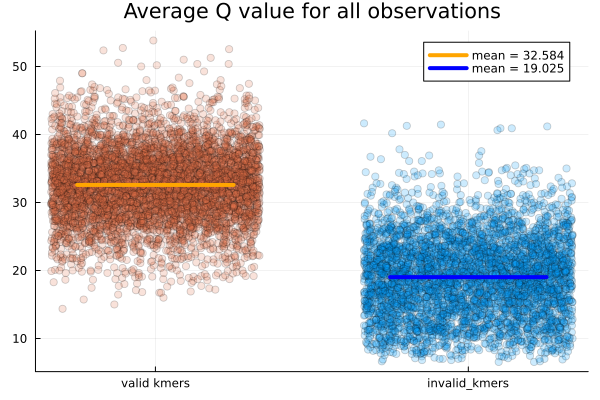

In [31]:
# here we ask what is the average quality of all of the considered kmers
valid_average_qualities = Float64[]
invalid_average_qualities = Float64[]
for (kmer, quality_values) in all_kmer_quality_support
    means = Statistics.mean.(quality_values)
    if kmer in reference_kmers
        append!(valid_average_qualities, means)
    else
        append!(invalid_average_qualities, means)
    end
end

p = StatsPlots.scatter(
    [jitter(2, length(invalid_average_qualities)), jitter(1, length(valid_average_qualities))],
    [invalid_average_qualities, valid_average_qualities],
    alpha=0.2,
    title = "Average Q value for all observations",
    xticks = ((1, 2), ("valid kmers", "invalid_kmers")),
    labels = nothing
)
StatsPlots.plot!(p, 
    [0.75, 1.25],
    [Statistics.mean(valid_average_qualities), Statistics.mean(valid_average_qualities)],
    linewidth=4,
    color=:orange,
    label = "mean = $(round(Statistics.mean(valid_average_qualities), digits=3))")
StatsPlots.plot!(p,
    [1.75, 2.25],
    [Statistics.mean(invalid_average_qualities), Statistics.mean(invalid_average_qualities)],
    linewidth=4,
    color=:blue,
    label="mean = $(round(Statistics.mean(invalid_average_qualities), digits=3))")

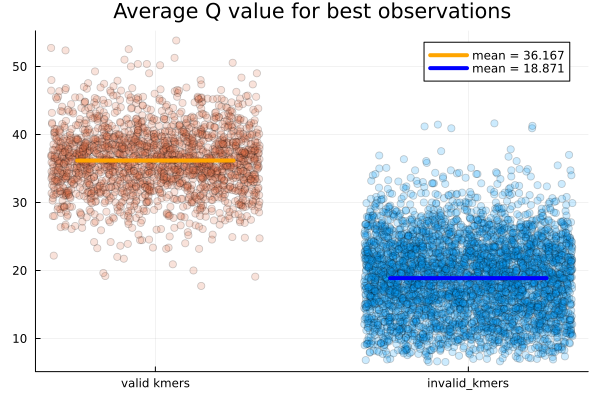

In [32]:
# average quality of the BEST observation
valid_max_average_qualities = Float64[]
invalid_max_average_qualities = Float64[]
for (kmer, quality_values) in all_kmer_quality_support
    means = Statistics.mean.(quality_values)
    if kmer in reference_kmers
        push!(valid_max_average_qualities, maximum(means))
    else
        push!(invalid_max_average_qualities, maximum(means))
    end
end

p = StatsPlots.scatter(
    [jitter(2, length(invalid_max_average_qualities)), jitter(1, length(valid_max_average_qualities))],
    [invalid_max_average_qualities, valid_max_average_qualities],
    alpha=0.2,
    title = "Average Q value for best observations",
    xticks = ((1, 2), ("valid kmers", "invalid_kmers")),
    labels = nothing
)
StatsPlots.plot!(p, 
    [0.75, 1.25],
    [Statistics.mean(valid_max_average_qualities), Statistics.mean(valid_max_average_qualities)],
    linewidth=4,
    color=:orange,
    label = "mean = $(round(Statistics.mean(valid_max_average_qualities), digits=3))")
StatsPlots.plot!(p,
    [1.75, 2.25],
    [Statistics.mean(invalid_max_average_qualities), Statistics.mean(invalid_max_average_qualities)],
    linewidth=4,
    color=:blue,
    label="mean = $(round(Statistics.mean(invalid_max_average_qualities), digits=3))")

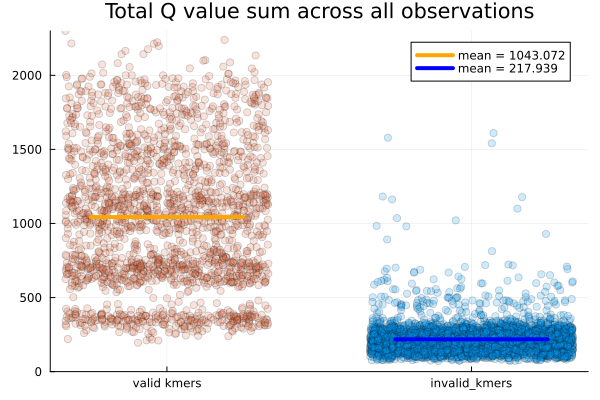

In [33]:
# here we ask what is the total quality of all of the considered kmers

state_quality_scores = sort(Dict(kmer => sum(sum.(quality_scores)) for (kmer, quality_scores) in all_kmer_quality_support))

valid_total_qualities = Float64[]
invalid_total_qualities = Float64[]
for (kmer, quality_values) in all_kmer_quality_support
    if kmer in reference_kmers
        push!(valid_total_qualities, state_quality_scores[kmer])
    else
        push!(invalid_total_qualities, state_quality_scores[kmer])
    end
end

p = StatsPlots.scatter(
    [jitter(2, length(invalid_total_qualities)), jitter(1, length(valid_total_qualities))],
    [invalid_total_qualities, valid_total_qualities],
    alpha=0.2,
    title = "Total Q value sum across all observations",
    xticks = ((1, 2), ("valid kmers", "invalid_kmers")),
    labels = nothing,
    ylims = (0, maximum(valid_total_qualities))
)
StatsPlots.plot!(p, 
    [0.75, 1.25],
    [Statistics.mean(valid_total_qualities), Statistics.mean(valid_total_qualities)],
    linewidth=4,
    color=:orange,
    label = "mean = $(round(Statistics.mean(valid_total_qualities), digits=3))")
StatsPlots.plot!(p,
    [1.75, 2.25],
    [Statistics.mean(invalid_total_qualities), Statistics.mean(invalid_total_qualities)],
    linewidth=4,
    color=:blue,
    label="mean = $(round(Statistics.mean(invalid_total_qualities), digits=3))")

In [39]:
# Now find the reverse-complement-aware total quality values

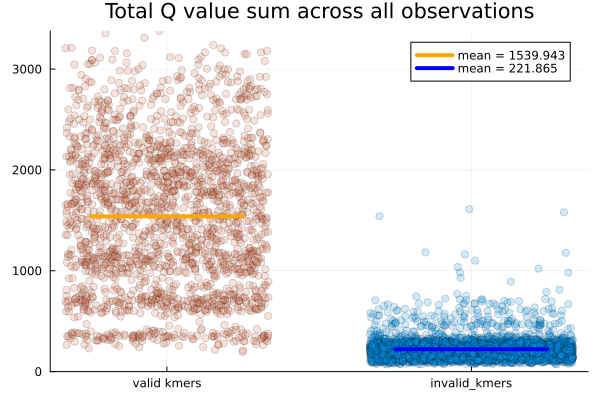

In [40]:
total_kmers = sum(values(kmer_counts))
total_states = length(kmer_counts)
kmers = collect(keys(kmer_counts))

adjusted_state_quality_scores = Dict{kmer_type, Float64}()
for kmer in kmers
    adjusted_state_quality_scores[kmer] = state_quality_scores[kmer]
    if haskey(adjusted_state_quality_scores, BioSequences.reverse_complement(kmer))
        adjusted_state_quality_scores[kmer] += state_quality_scores[BioSequences.reverse_complement(kmer)]
    end
end
adjusted_state_quality_scores

# here we ask what is the total quality of all of the considered kmers
valid_adjusted_qualities = Float64[]
invalid_adjusted_qualities = Float64[]
for kmer in kmers
    if kmer in reference_kmers
        push!(valid_adjusted_qualities, adjusted_state_quality_scores[kmer])
    else
        push!(invalid_adjusted_qualities, adjusted_state_quality_scores[kmer])
    end
end

p = StatsPlots.scatter(
    [jitter(2, length(invalid_adjusted_qualities)), jitter(1, length(valid_adjusted_qualities))],
    [invalid_adjusted_qualities, valid_adjusted_qualities],
    alpha=0.2,
    title = "Total Q value sum across all observations",
    xticks = ((1, 2), ("valid kmers", "invalid_kmers")),
    labels = nothing,
    ylims = (0, maximum(valid_adjusted_qualities))
)
StatsPlots.plot!(p, 
    [0.75, 1.25],
    [Statistics.mean(valid_adjusted_qualities), Statistics.mean(valid_adjusted_qualities)],
    linewidth=4,
    color=:orange,
    label = "mean = $(round(Statistics.mean(valid_adjusted_qualities), digits=3))")
StatsPlots.plot!(p,
    [1.75, 2.25],
    [Statistics.mean(invalid_adjusted_qualities), Statistics.mean(invalid_adjusted_qualities)],
    linewidth=4,
    color=:blue,
    label="mean = $(round(Statistics.mean(invalid_adjusted_qualities), digits=3))")

In [ ]:
# here we ask what is the total quality of all of the considered kmers
valid_total_qualities = Float64[]
invalid_total_qualities = Float64[]
for (kmer, quality_values) in all_kmer_quality_support
    if kmer in reference_kmers
        push!(valid_total_qualities, sum(sum.(quality_values)))
    else
        push!(invalid_total_qualities, sum(sum.(quality_values)))
    end
end

p = StatsPlots.scatter(
    [jitter(2, length(invalid_total_qualities)), jitter(1, length(valid_total_qualities))],
    [invalid_total_qualities, valid_total_qualities],
    alpha=0.2,
    title = "Total Q value sum across all observations",
    xticks = ((1, 2), ("valid kmers", "invalid_kmers")),
    labels = nothing,
    ylims = (0, maximum(valid_total_qualities))
)
StatsPlots.plot!(p, 
    [0.75, 1.25],
    [Statistics.mean(valid_total_qualities), Statistics.mean(valid_total_qualities)],
    linewidth=4,
    color=:orange,
    label = "mean = $(round(Statistics.mean(valid_total_qualities), digits=3))")
StatsPlots.plot!(p,
    [1.75, 2.25],
    [Statistics.mean(invalid_total_qualities), Statistics.mean(invalid_total_qualities)],
    linewidth=4,
    color=:blue,
    label="mean = $(round(Statistics.mean(invalid_total_qualities), digits=3))")

In [ ]:
state_likelihoods = Dict(kmer => kmer_count / total_kmers for (kmer, kmer_count) in kmer_counts)

In [ ]:
transition_likelihoods = SparseArrays.spzeros(total_states, total_states)
for record in records
    sequence = BioSequences.LongDNA{4}(FASTX.sequence(record))
    sources = Kmers.EveryKmer{kmer_type}(sequence[1:end-1])
    destinations = Kmers.EveryKmer{kmer_type}(sequence[2:end])
    for ((source_i, source), (destination_i, destination)) in zip(sources, destinations)
        source_index = kmer_indices[source]
        destination_index = kmer_indices[destination]
        transition_likelihoods[source_index, destination_index] += 1
    end
end
for source in 1:total_states
    # @show source
    outgoing_transition_counts = transition_likelihoods[source, :]
    if sum(outgoing_transition_counts) > 0
        transition_likelihoods[source, :] .= transition_likelihoods[source, :] ./ sum(transition_likelihoods[source, :]) 
    end
end
transition_likelihoods

In [ ]:
g = Graphs.SimpleDiGraph(total_states)
row_indices, column_indices, cell_values = SparseArrays.findnz(transition_likelihoods)
for (row, col) in zip(row_indices, column_indices)
    Graphs.add_edge!(g, row, col)
end
g

In [ ]:
unbranching_nodes = Set(Int[])
for node in Graphs.vertices(g)
    if (Graphs.indegree(g, node) <= 1) && (Graphs.outdegree(g, node) <= 1)
        push!(unbranching_nodes, node)
    end
end
unvisited_unbranching_nodes = Set(unbranching_nodes)

In [ ]:
branching_nodes = setdiff(Graphs.vertices(g), unbranching_nodes)
for branching_node in branching_nodes
    @assert Graphs.degree(g, branching_node) >= 2
end
inbranching_nodes = filter(node -> Graphs.indegree(g, node) > 1, branching_nodes)
outbranching_nodes = filter(node -> Graphs.outdegree(g, node) > 1, branching_nodes)

In [ ]:
unbranching_paths = []
while !isempty(unvisited_unbranching_nodes)
    current_path = [rand(unvisited_unbranching_nodes)]
    delete!(unvisited_unbranching_nodes, first(current_path))

    outneighbors = Graphs.outneighbors(g, last(current_path))

    while length(outneighbors) == 1
        outneighbor = first(outneighbors)
        outneighbors_inneighbors = Graphs.inneighbors(g, outneighbor)
        if outneighbors_inneighbors == [last(current_path)]
            push!(current_path, outneighbor)
            delete!(unvisited_unbranching_nodes, outneighbor)
            outneighbors = Graphs.outneighbors(g, outneighbor)
        else
            @assert length(outneighbors_inneighbors) > 1
            push!(current_path, outneighbor)
            delete!(unvisited_unbranching_nodes, outneighbor)
            break
        end
    end
    inneighbors = Graphs.inneighbors(g, first(current_path))
    while length(inneighbors) == 1
        inneighbor = first(inneighbors)
        inneighbors_outneighbors = Graphs.outneighbors(g, inneighbor)
        if inneighbors_outneighbors == [first(current_path)]
            pushfirst!(current_path, inneighbor)
            delete!(unvisited_unbranching_nodes, inneighbor)
            inneighbors = Graphs.inneighbors(g, inneighbor)
        else
            @assert length(inneighbors_outneighbors) > 1
            pushfirst!(current_path, inneighbor)
            delete!(unvisited_unbranching_nodes, inneighbor)
            break
        end
    end
    push!(unbranching_paths, current_path)
end
unbranching_paths

In [ ]:
unbranching_path_scores = Int[]
state_scores = collect(values(state_quality_scores))
for unbranching_path in unbranching_paths
    push!(unbranching_path_scores, sum(state_scores[state] for state in unbranching_path))
end
StatsPlots.histogram(unbranching_path_scores)
# unbranching_path_scores

In [ ]:
# branching_nodes

In [ ]:
# all(node -> kmers[node] in reference_kmers, branching_nodes)

In [ ]:
# solid nodes
# branch points


In [ ]:
# [any(node -> node in reference_kmers, unbranching_path) for unbranching_path in unbranching_paths]

In [ ]:
# sum([all(node -> kmers[node] in reference_kmers, unbranching_path) for unbranching_path in unbranching_paths])

In [ ]:
kmers = collect(keys(kmer_counts))

In [ ]:
path_support = Vector{Float64}[]
for unbranching_path in unbranching_paths
    push!(path_support, [state_likelihoods[collect(keys(kmer_counts))[state]] for state in unbranching_path])
    # push!(path_support, [kmer_quality_support[collect(keys(kmer_counts))[state]] for state in unbranching_path])
end
path_support

p = StatsPlots.scatter(
    # sort(Statistics.mean.(path_support)),
    sort(Statistics.median.(path_support)),
    title = "median kmer likelihood of unbranching paths",
    legend=false,
    ylabel = ""
)

# low_support_path_unbranching_path_indices = findall(Statistics.mean.(path_support) .< Statistics.median(Statistics.mean.(path_support)))
# low_support_path_unbranching_path_indices = findall(Statistics.mean.(path_support) .< Statistics.median(Statistics.mean.(path_support)))

StatsPlots.hline!(p, [Statistics.mean(Statistics.median.(path_support))], label = "mean of the medians")

In [ ]:
# now use the shortest path algorithm

In [ ]:
Use yen k shortest paths to find the best replacement route for flagged routes that we are going to drop
    
distances = 1 / median

In [ ]:
distance matrix is 

In [ ]:
# let's read in the original genome in the forward and backward orientations to identify which kmers are actually true

In [ ]:
# which nodes are not in the unbranching paths - should only be the hub nodes that would be the basis of the simplified graph?


In [ ]:
Graphs.inneighbors(g, unbranching_paths[1])

In [ ]:
unbranching_paths

In [ ]:


# low_support_path_unbranching_path_indices = findall(Statistics.mean.(path_support) .< Statistics.median(Statistics.mean.(path_support)))
# low_support_path_unbranching_path_indices = findall(Statistics.mean.(path_support) .< Statistics.median(Statistics.mean.(path_support)))

# StatsPlots.hline!(p, [Statistics.mean(Statistics.median.(path_support))], label = "mean of the medians")
# StatsPlots.hline!(p, [Statistics.median(Statistics.mean.(path_support))], label = "median of the means")

In [ ]:
path_support = Vector{Float64}[]
for unbranching_path in unbranching_paths
    # push!(path_support, [state_likelihoods[collect(keys(kmer_counts))[state]] for state in unbranching_path])
    push!(path_support, [kmer_quality_support[collect(keys(kmer_counts))[state]] for state in unbranching_path])
end
path_support

p = StatsPlots.scatter(
    sort(Statistics.mean.(path_support)),
    title = "average kmer quality score of unbranching paths",
    labels="mean unbranching path likelihood",
    ylabel = ""
)

low_support_path_unbranching_path_indices = findall(Statistics.mean.(path_support) .< Statistics.median(Statistics.mean.(path_support)))

# StatsPlots.hline!(p, [Statistics.mean(Statistics.median.(path_support))], label = "mean of the medians")
StatsPlots.hline!(p, [Statistics.median(Statistics.mean.(path_support))], label = "median of the means")

In [ ]:
quality_threshold = min(Statistics.median(quality_scores), Statistics.mean(quality_scores))

In [ ]:
state_likelihood_threshold = min(Statistics.mean(collect(values(state_likelihoods))), Statistics.median(collect(values(state_likelihoods))))

In [ ]:
nonzero_transition_likelihoods = filter(x -> x > 0, vec(transition_likelihoods))

In [ ]:
transition_likelihood_treshold = min(Statistics.mean(nonzero_transition_likelihoods), Statistics.median(nonzero_transition_likelihoods))

In [ ]:
kmer_count_threshold = Statistics.mean(collect(values(kmer_counts)))

In [ ]:
record = first(records)

sequence = BioSequences.LongDNA{4}(FASTX.sequence(record))

record_kmers = Kmers.EveryKmer{kmer_type}(sequence)

record_quality_scores = collect(FASTX.quality_scores(record))
record_quality_score_slices = [record_quality_scores[i:i+k-1] for i in 1:length(record_quality_scores)-k+1]

kmer_count_values = [kmer_counts[kmer] for kmer in last.(Kmers.EveryKmer{kmer_type}(sequence))]
p = StatsPlots.plot(
    kmer_count_values,
    title = "state frequency across fastq record",
    xlabel = "read index",
    ylabel = "total equivalent observations",
    labels = "# of equivalent observations"
)
StatsPlots.hline!(p, [kmer_count_threshold], label = "threshold")

In [ ]:
p = StatsPlots.plot(
    [
        Statistics.mean.(record_quality_score_slices),
    ],
    ylabel = "quality score",
    xlabel = "read index",
    title = "quality scores across fastq record",
    labels = "mean"
)
StatsPlots.hline!(p, [quality_threshold], labels = "quality threshold")

In [ ]:
sources = Kmers.EveryKmer{kmer_type}(sequence[1:end-1])
destinations = Kmers.EveryKmer{kmer_type}(sequence[2:end])
transition_likelihood_values = [transition_likelihoods[kmer_indices[source], kmer_indices[destination]] for ((source_i, source), (destination_i, destination)) in zip(sources, destinations)]

p = StatsPlots.plot(
    transition_likelihood_values,
    title = "transition likelihoods across fastq record",
    label = false,
    ylabel = "relative likelihood",
    xlabel = "read index"
)
StatsPlots.hline!(p, [transition_likelihood_treshold], label = "threshold")

In [ ]:
kmer_count_flags = findall(kmer_count_values .< kmer_count_threshold)

In [ ]:
quality_score_flags = findall(Statistics.mean.(record_quality_score_slices) .< quality_threshold)

In [ ]:


transition_likelihood_flags = findall(transition_likelihood_values .< transition_likelihood_treshold)
hit_results = StatsBase.countmap(vcat(kmer_count_flags, quality_score_flags, transition_likelihood_flags))
StatsPlots.scatter(
    first.(sort(collect(hit_results))),
    last.(sort(collect(hit_results))),
    legend = false,
    title = "# of flags thrown at record index",
    ylabel = "# of flags",
    xlabel = "record index"
)

In [ ]:
universally_flagged_indices = sort(collect(keys(filter(hit_result -> hit_result[2] == maximum(values(hit_results)), hit_results))))
universally_flagged_kmers = last.(collect(record_kmers))[universally_flagged_indices]
universally_flagged_kmer_indices = sort([kmer_indices[universally_flagged_kmer] for universally_flagged_kmer in universally_flagged_kmers])

intersect(universally_flagged_kmer_indices, reduce(vcat, unbranching_paths[low_support_path_unbranching_path_indices]))

In [ ]:
universally_flagged_kmer_indices

In [ ]:
reduce(vcat, unbranching_paths[low_support_path_unbranching_path_indices])

In [ ]:
# low_support_unbranching_paths = Dict(x => iunbranching_paths[low_support_paths]

In [ ]:
# for low_support_unbranching_paths

In [ ]:
function polish_fastx(fastx; k=Mycelia.assess_dnamer_saturation([fastx], plot=false))
    kmer_type = Kmers.DNAKmer{k}
    canonical_kmer_counts = Mycelia.count_canonical_kmers(kmer_type, fastx)
    
    
    solid_threshold = floor(Statistics.mean(values(canonical_kmer_counts)))
    # solid_threshold
    @show solid_threshold
    
    stranded_kmer_counts = copy(canonical_kmer_counts)
    for (canonical_kmer, count) in canonical_kmer_counts
        stranded_kmer_counts[BioSequences.reverse_complement(canonical_kmer)] = count
    end
    sort!(stranded_kmer_counts)

    stranded_kmer_graph = MetaGraphs.MetaDiGraph(length(stranded_kmer_counts))
    MetaGraphs.set_prop!(stranded_kmer_graph, :k, k)
    for (i, (stranded_kmer, count)) in enumerate(stranded_kmer_counts)
        MetaGraphs.set_prop!(stranded_kmer_graph, i, :kmer, stranded_kmer)
        MetaGraphs.set_prop!(stranded_kmer_graph, i, :count, count)
    end
    MetaGraphs.set_indexing_prop!(stranded_kmer_graph, :kmer)
    # stranded_kmer_graph
    records = collect(Mycelia.open_fastx(fastx))
    for record in records
        sequence = BioSequences.LongDNA{4}(FASTX.sequence(record))
        sources = Kmers.EveryKmer{kmer_type}(sequence[1:end-1])
        destinations = Kmers.EveryKmer{kmer_type}(sequence[2:end])
        for (i, ((source_i, source), (destination_i, destination))) in enumerate(zip(sources, destinations))
            source_vertex = stranded_kmer_graph[source, :kmer]
            destination_vertex = stranded_kmer_graph[destination, :kmer]
            edge = Graphs.Edge(source_vertex, destination_vertex)
            observation = (record_identifier = FASTX.description(record), index = i, orientation = true)
            if !Graphs.has_edge(stranded_kmer_graph, edge)
                Graphs.add_edge!(stranded_kmer_graph, edge)
                MetaGraphs.set_prop!(stranded_kmer_graph, edge, :observations, Set([observation]))
            else
                observations = push!(MetaGraphs.get_prop(stranded_kmer_graph, edge, :observations), observation)
                MetaGraphs.set_prop!(stranded_kmer_graph, edge, :observations, observations)
            end

            # reverse_complement!
            source_vertex = stranded_kmer_graph[BioSequences.reverse_complement(destination), :kmer]
            destination_vertex = stranded_kmer_graph[BioSequences.reverse_complement(source), :kmer]
            edge = Graphs.Edge(source_vertex, destination_vertex)
            observation = (record_identifier = FASTX.description(record), index = i, orientation = false)
            if !Graphs.has_edge(stranded_kmer_graph, edge)
                Graphs.add_edge!(stranded_kmer_graph, edge)
                MetaGraphs.set_prop!(stranded_kmer_graph, edge, :observations, Set([observation]))
            else
                observations = push!(MetaGraphs.get_prop(stranded_kmer_graph, edge, :observations), observation)
                MetaGraphs.set_prop!(stranded_kmer_graph, edge, :observations, observations)
            end
        end
    end
    stranded_kmer_graph

    unbranching_nodes = Int[]
    for node in Graphs.vertices(stranded_kmer_graph)
        if (Graphs.indegree(stranded_kmer_graph, node) == 1) && (Graphs.outdegree(stranded_kmer_graph, node) == 1)
            push!(unbranching_nodes, node)
        end
    end
    unvisited_unbranching_nodes = Set(unbranching_nodes)

    unbranching_paths = []
    while !isempty(unvisited_unbranching_nodes)
        current_path = [rand(unvisited_unbranching_nodes)]
        delete!(unvisited_unbranching_nodes, first(current_path))

        outneighbors = Graphs.outneighbors(stranded_kmer_graph, last(current_path))

        while length(outneighbors) == 1
            outneighbor = first(outneighbors)
            outneighbors_inneighbors = Graphs.inneighbors(stranded_kmer_graph, outneighbor)
            if outneighbors_inneighbors == [last(current_path)]
                push!(current_path, outneighbor)
                delete!(unvisited_unbranching_nodes, outneighbor)
                outneighbors = Graphs.outneighbors(stranded_kmer_graph, outneighbor)
            else
                @assert length(outneighbors_inneighbors) > 1
                push!(current_path, outneighbor)
                delete!(unvisited_unbranching_nodes, outneighbor)
                break
            end
        end
        # @show Graphs.outneighbors(stranded_kmer_graph, current_node)
        inneighbors = Graphs.inneighbors(stranded_kmer_graph, first(current_path))
        while length(inneighbors) == 1
            inneighbor = first(inneighbors)
            inneighbors_outneighbors = Graphs.outneighbors(stranded_kmer_graph, inneighbor)
            if inneighbors_outneighbors == [first(current_path)]
                pushfirst!(current_path, inneighbor)
                delete!(unvisited_unbranching_nodes, inneighbor)
                inneighbors = Graphs.inneighbors(stranded_kmer_graph, inneighbor)
            else
                @assert length(inneighbors_outneighbors) > 1
                pushfirst!(current_path, inneighbor)
                delete!(unvisited_unbranching_nodes, inneighbor)
                break
            end
        end
        push!(unbranching_paths, current_path)
    end
    unbranching_paths

    unbranching_path_state_weights = [map(v -> MetaGraphs.get_prop(stranded_kmer_graph, v, :count), path) for path in unbranching_paths]

    solid_unbranching_paths = unbranching_paths[minimum.(unbranching_path_state_weights) .>= solid_threshold]

    # beginnings = filter(path -> Graphs.indegree(stranded_kmer_graph, first(path)) == 0, solid_unbranching_paths)
    # ends = filter(path -> Graphs.outdegree(stranded_kmer_graph, last(path)) == 0, solid_unbranching_paths)
    # mids = setdiff(setdiff(solid_unbranching_paths, beginnings), ends)
    # branch_points = filter(v -> Graphs.indegree(stranded_kmer_graph, v) > 1 || Graphs.outdegree(stranded_kmer_graph, v) > 1, Graphs.vertices(stranded_kmer_graph))
    # @assert all(x -> x in branch_points, first.(mids))
    # @assert all(x -> x in branch_points, last.(mids))
    # @assert all(x -> x in branch_points, first.(ends))
    # @assert all(x -> x in branch_points, last.(beginnings))

    solid_kmers = Set(collect(keys(filter(x -> x[2] >= solid_threshold, stranded_kmer_counts))))

    solid_vertices = filter(v -> MetaGraphs.get_prop(stranded_kmer_graph, v, :count) >= solid_threshold, Graphs.vertices(stranded_kmer_graph))

    solid_subgraph, vertex_map = Graphs.induced_subgraph(stranded_kmer_graph, solid_vertices)
    MetaGraphs.set_indexing_prop!(solid_subgraph, :kmer)
    distance_matrix = SparseArrays.spzeros(Graphs.nv(solid_subgraph), Graphs.nv(solid_subgraph))
    for edge in Graphs.edges(solid_subgraph)
        # @show edge
        observations = MetaGraphs.get_prop(solid_subgraph, edge, :observations)
        # @show length(observations)
        distance_matrix[edge.src, edge.dst] = distance_matrix[edge.dst, edge.src] = 1/length(observations)
    end
    distance_matrix

    updated_records = FASTX.FASTA.Record[]
    for record in records
        record_kmers = last.(collect(Kmers.EveryKmer{kmer_type}(BioSequences.LongDNA{4}(FASTX.sequence(record)))))
        kmer_is_solid = map(kmer -> kmer in solid_kmers, record_kmers)
        if all(kmer_is_solid)
            push!(updated_records, record)
        else
            junctions_to_resample = find_weak_runs(kmer_is_solid)
            while !isempty(junctions_to_resample)
                junction_to_resample = first(junctions_to_resample)
                start_index = first(junction_to_resample)
                if start_index > 1
                    start_index -= 1
                end
                stop_index = last(junction_to_resample)
                if stop_index < length(record_kmers)
                    stop_index += 1
                end
                # @show start_index
                # @show stop_index

                if first(junction_to_resample) == 1
                    record_kmers = [record_kmers[stop_index:end]...]
                elseif last(junction_to_resample) == length(record_kmers)
                    record_kmers = [record_kmers[1:start_index]...]
                else
                    # @assert haskey(solid_kmers, start_index)
                    # @assert haskey(solid_kmers, stop_index)
                    start_vertex = solid_subgraph[record_kmers[start_index], :kmer]
                    stop_vertex = solid_subgraph[record_kmers[stop_index], :kmer]
                    replacement_path = Graphs.a_star(solid_subgraph, start_vertex, stop_vertex, distance_matrix)
                    record_kmers = [record_kmers[1:start_index]..., [solid_subgraph[edge.dst, :kmer] for edge in replacement_path[1:end-1]]..., record_kmers[stop_index:end]...]
                end
                kmer_is_solid = map(kmer -> kmer in solid_kmers, record_kmers)
                junctions_to_resample = find_weak_runs(kmer_is_solid)
            end
            new_sequence = BioSequences.LongDNA{4}(first(record_kmers))
            for kmer in record_kmers[2:end]
                push!(new_sequence, last(kmer))
            end
            push!(updated_records, FASTX.FASTA.Record(FASTX.description(record), new_sequence))
        end
    end
    return (;updated_records, k)
end

In [ ]:
kmer_type = Kmers.DNAKmer{k}
kmer_counts = Mycelia.count_kmers(kmer_type, fasta)

In [ ]:


    unbranching_nodes = Int[]
    for node in Graphs.vertices(stranded_kmer_graph)
        if (Graphs.indegree(stranded_kmer_graph, node) == 1) && (Graphs.outdegree(stranded_kmer_graph, node) == 1)
            push!(unbranching_nodes, node)
        end
    end
    unvisited_unbranching_nodes = Set(unbranching_nodes)

    unbranching_paths = []
    while !isempty(unvisited_unbranching_nodes)
        current_path = [rand(unvisited_unbranching_nodes)]
        delete!(unvisited_unbranching_nodes, first(current_path))

        outneighbors = Graphs.outneighbors(stranded_kmer_graph, last(current_path))

        while length(outneighbors) == 1
            outneighbor = first(outneighbors)
            outneighbors_inneighbors = Graphs.inneighbors(stranded_kmer_graph, outneighbor)
            if outneighbors_inneighbors == [last(current_path)]
                push!(current_path, outneighbor)
                delete!(unvisited_unbranching_nodes, outneighbor)
                outneighbors = Graphs.outneighbors(stranded_kmer_graph, outneighbor)
            else
                @assert length(outneighbors_inneighbors) > 1
                push!(current_path, outneighbor)
                delete!(unvisited_unbranching_nodes, outneighbor)
                break
            end
        end
        # @show Graphs.outneighbors(stranded_kmer_graph, current_node)
        inneighbors = Graphs.inneighbors(stranded_kmer_graph, first(current_path))
        while length(inneighbors) == 1
            inneighbor = first(inneighbors)
            inneighbors_outneighbors = Graphs.outneighbors(stranded_kmer_graph, inneighbor)
            if inneighbors_outneighbors == [first(current_path)]
                pushfirst!(current_path, inneighbor)
                delete!(unvisited_unbranching_nodes, inneighbor)
                inneighbors = Graphs.inneighbors(stranded_kmer_graph, inneighbor)
            else
                @assert length(inneighbors_outneighbors) > 1
                pushfirst!(current_path, inneighbor)
                delete!(unvisited_unbranching_nodes, inneighbor)
                break
            end
        end
        push!(unbranching_paths, current_path)
    end
    unbranching_paths

    unbranching_path_state_weights = [map(v -> MetaGraphs.get_prop(stranded_kmer_graph, v, :count), path) for path in unbranching_paths]

    solid_unbranching_paths = unbranching_paths[minimum.(unbranching_path_state_weights) .>= solid_threshold]

    # beginnings = filter(path -> Graphs.indegree(stranded_kmer_graph, first(path)) == 0, solid_unbranching_paths)
    # ends = filter(path -> Graphs.outdegree(stranded_kmer_graph, last(path)) == 0, solid_unbranching_paths)
    # mids = setdiff(setdiff(solid_unbranching_paths, beginnings), ends)
    # branch_points = filter(v -> Graphs.indegree(stranded_kmer_graph, v) > 1 || Graphs.outdegree(stranded_kmer_graph, v) > 1, Graphs.vertices(stranded_kmer_graph))
    # @assert all(x -> x in branch_points, first.(mids))
    # @assert all(x -> x in branch_points, last.(mids))
    # @assert all(x -> x in branch_points, first.(ends))
    # @assert all(x -> x in branch_points, last.(beginnings))

    solid_kmers = Set(collect(keys(filter(x -> x[2] >= solid_threshold, stranded_kmer_counts))))

    solid_vertices = filter(v -> MetaGraphs.get_prop(stranded_kmer_graph, v, :count) >= solid_threshold, Graphs.vertices(stranded_kmer_graph))

    solid_subgraph, vertex_map = Graphs.induced_subgraph(stranded_kmer_graph, solid_vertices)
    MetaGraphs.set_indexing_prop!(solid_subgraph, :kmer)
    distance_matrix = SparseArrays.spzeros(Graphs.nv(solid_subgraph), Graphs.nv(solid_subgraph))
    for edge in Graphs.edges(solid_subgraph)
        # @show edge
        observations = MetaGraphs.get_prop(solid_subgraph, edge, :observations)
        # @show length(observations)
        distance_matrix[edge.src, edge.dst] = distance_matrix[edge.dst, edge.src] = 1/length(observations)
    end
    distance_matrix

    updated_records = FASTX.FASTA.Record[]
    for record in records
        record_kmers = last.(collect(Kmers.EveryKmer{kmer_type}(BioSequences.LongDNA{4}(FASTX.sequence(record)))))
        kmer_is_solid = map(kmer -> kmer in solid_kmers, record_kmers)
        if all(kmer_is_solid)
            push!(updated_records, record)
        else
            junctions_to_resample = find_weak_runs(kmer_is_solid)
            while !isempty(junctions_to_resample)
                junction_to_resample = first(junctions_to_resample)
                start_index = first(junction_to_resample)
                if start_index > 1
                    start_index -= 1
                end
                stop_index = last(junction_to_resample)
                if stop_index < length(record_kmers)
                    stop_index += 1
                end
                # @show start_index
                # @show stop_index

                if first(junction_to_resample) == 1
                    record_kmers = [record_kmers[stop_index:end]...]
                elseif last(junction_to_resample) == length(record_kmers)
                    record_kmers = [record_kmers[1:start_index]...]
                else
                    # @assert haskey(solid_kmers, start_index)
                    # @assert haskey(solid_kmers, stop_index)
                    start_vertex = solid_subgraph[record_kmers[start_index], :kmer]
                    stop_vertex = solid_subgraph[record_kmers[stop_index], :kmer]
                    replacement_path = Graphs.a_star(solid_subgraph, start_vertex, stop_vertex, distance_matrix)
                    record_kmers = [record_kmers[1:start_index]..., [solid_subgraph[edge.dst, :kmer] for edge in replacement_path[1:end-1]]..., record_kmers[stop_index:end]...]
                end
                kmer_is_solid = map(kmer -> kmer in solid_kmers, record_kmers)
                junctions_to_resample = find_weak_runs(kmer_is_solid)
            end
            new_sequence = BioSequences.LongDNA{4}(first(record_kmers))
            for kmer in record_kmers[2:end]
                push!(new_sequence, last(kmer))
            end
            push!(updated_records, FASTX.FASTA.Record(FASTX.description(record), new_sequence))
        end
    end
    return (;updated_records, k)

In [ ]:
Random.seed!(20240209)
genome = BioSequences.randdnaseq(100)
initial_records = [FASTX.FASTA.Record(Random.randstring(), Mycelia.observe(genome, error_rate=0.01)) for i in 1:100]
prior_records = initial_records
fasta = Mycelia.write_fasta(records = prior_records, outfile = joinpath(working_dir, Random.randstring() * ".fna"))
updated_records, k = polish_fastx(fasta)
prior_records == updated_records

In [ ]:
prior_records = updated_records
temp_fasta = Mycelia.write_fasta(records = prior_records)
updated_records, k = polish_fastx(temp_fasta, k = Primes.nextprime(k+1))
prior_records == updated_records

In [ ]:
prior_records = updated_records
temp_fasta = Mycelia.write_fasta(records = prior_records)
updated_records, k = polish_fastx(temp_fasta, k = Primes.nextprime(k+1))
prior_records == updated_records

In [ ]:
prior_records = updated_records
temp_fasta = Mycelia.write_fasta(records = prior_records)
updated_records, k = polish_fastx(temp_fasta, k = Primes.nextprime(k+1))
prior_records == updated_records

In [ ]:
fasta

In [ ]:
updated_fasta = Mycelia.write_fasta(records = updated_records, outfile = fasta * ".updated.fna")

In [ ]:
#NEED TO FIX CANONICAL KMER GRAPHS AND GFA OUTPUT - THE REST SEEMS CORRECT

In [ ]:
k = Primes.nextprime(k+1)
# make my own kmer graph
assembly_graph = Mycelia.fastx_to_kmer_graph(Kmers.DNAKmer{k}, updated_fasta)
gfa_file = updated_fasta * ".gfa"
Mycelia.graph_to_gfa(graph=assembly_graph, outfile=gfa_file)
image = gfa_file * ".mycelia.gfa.jpg"
# run(`chmod +x $(homedir())/software/bin/Bandage`)
run(`$(homedir())/software/bin/Bandage image $(gfa_file) $(image)`)